In [1]:
%load_ext autoreload
%autoreload 2

import os
import sys

import numpy as np
import torch
import torchio as tio
import h5py
from ipywidgets import interact
import matplotlib.pyplot as plt

dir2 = os.path.abspath('..')
dir1 = os.path.dirname(dir2)
if not dir1 in sys.path: 
    sys.path.append(dir1)

In [67]:
from pathlib import Path
from PIL import Image
from research.scripts.bigbigan import imshow, imgrid, image_to_uint8

stimulus_ids = ['1443537.022563', '1621127.019020', '1677366.018182', '1846331.017038', '1858441.011077', '1943899.024131', '1976957.013223', '2071294.046212', '2128385.020264', '2139199.010398', '2190790.015121', '2274259.024319', '2416519.012793', '2437136.012836', '2437971.005013', '2690373.007713', '2797295.015411', '2824058.018729', '2882301.014188', '2916179.024850', '2950256.022949', '2951358.023759', '3064758.038750', '3122295.031279', '3124170.013920', '3237416.058334', '3272010.011001', '3345837.012501', '3379051.008496', '3452741.024622', '3455488.028622', '3482252.022530', '3495258.009895', '3584254.005040', '3626115.019498', '3710193.022225', '3716966.028524', '3761084.043533', '3767745.000109', '3941684.021672', '3954393.010038', '4210120.009062', '4252077.010859', '4254777.016338', '4297750.025624', '4387400.016693', '4507155.021299', '4533802.019479', '4554684.053399', '4572121.003262']

model_name = 'ViT-B=32'
feature_name = 'embedding'
code_name = 'contrastive-z-adversarial-v1.2'
subject = 'sub-03'

root = Path('X:\\Datasets\\Deep-Image-Reconstruction')
results_path = root / 'derivatives' / 'results' / model_name / feature_name / code_name / subject
images_path = results_path / 'images'
out_path = results_path / 'custom'
out_path.mkdir(exist_ok=True)
stimulus_images = h5py.File(root / "derivatives" / "stimulus_images.hdf5", "r")

(3, 50, 224, 224, 3)
(4, 50, 224, 224, 3)
(40, 224, 224, 3)


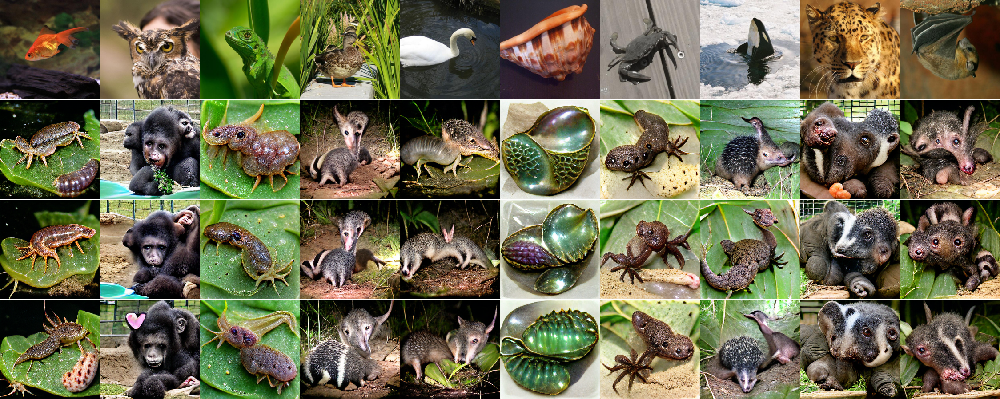

(40, 224, 224, 3)


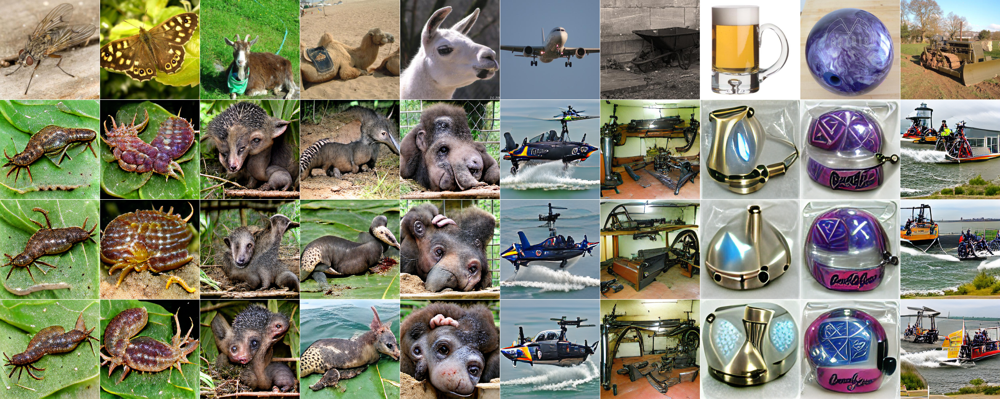

(40, 224, 224, 3)


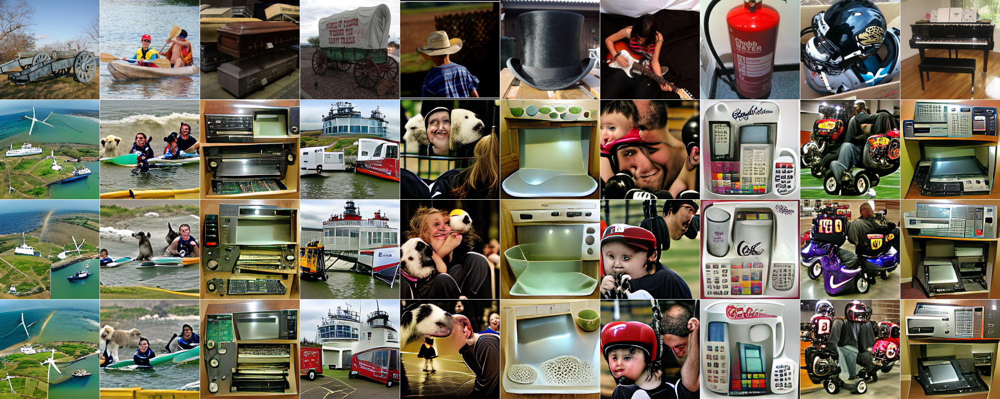

(40, 224, 224, 3)


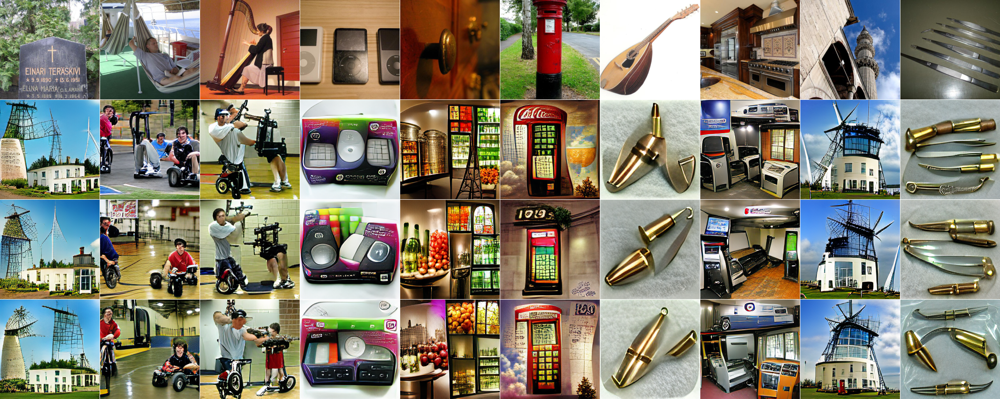

(40, 224, 224, 3)


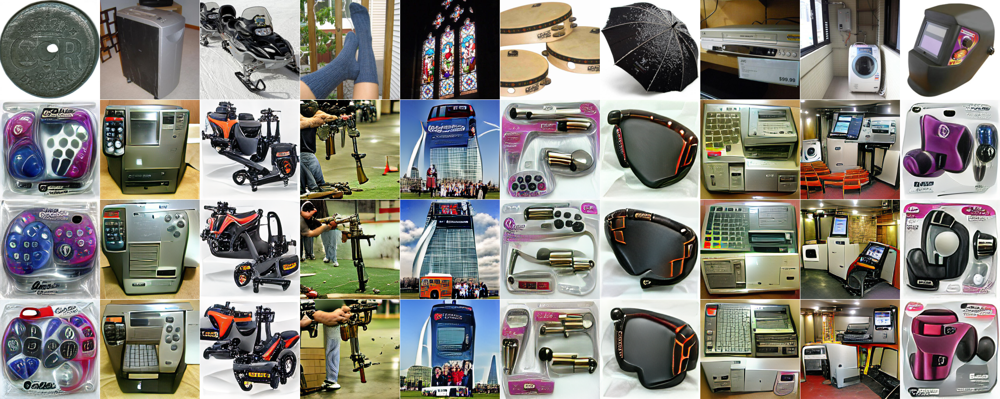

In [69]:
from einops import rearrange
from torchvision import transforms

batch_ids = [0, 1, 2]

batches = []
for batch_id in batch_ids:
    
    if code_name == 'standard':
        file_paths = list(images_path.iterdir())
        file_paths.sort(key=lambda p: int(p.name.split('-')[1]))
        file_paths = [list(p.iterdir())[0] for p in file_paths]
    else:
        batch_path = images_path / f'batch-{batch_id}'
        file_paths = list(batch_path.iterdir())
        file_paths.sort(key=lambda p: int(p.name.split('_')[3].split('-')[-1]))
    images = np.stack([np.array(Image.open(p)) for p in file_paths])
    batches.append(images)
batches = np.stack(batches)
print(batches.shape)

x_all = []
for i, stimulus_id in enumerate(stimulus_ids):
    image_data = stimulus_images[stimulus_id]['data'][:]
    image = Image.fromarray(image_data)

    size = 224
    image = transforms.Resize(size)(image)
    x_all.append(np.array(image))
x_all = np.stack(x_all)
x_all = np.concatenate([x_all[None], batches])

cols = 10
splits = 50 // cols

print(x_all.shape)
#for i in range(splits):
    
for i, x_group in enumerate(np.split(x_all, splits, axis=1)):
    
    x_group = rearrange(x_group, 'b n h w c -> (b n) h w c')
    print(x_group.shape)
    out_img = imgrid(x_group, cols=cols)
    Image.fromarray(out_img).save(out_path / f'{model_name}__{feature_name}__{code_name}__{subject}__{i*splits}-{(i+1)*splits}.png')

    imshow(out_img)

In [20]:
np.array(images[0])

array([[[ 0,  0,  4],
        [ 0,  4, 10],
        [ 0,  8, 16],
        ...,
        [14, 15, 33],
        [17, 21, 44],
        [18, 23, 28]],

       [[11,  3, 19],
        [ 4,  9,  8],
        [ 8,  8, 15],
        ...,
        [10,  5,  9],
        [16, 22, 38],
        [18, 17, 34]],

       [[ 4,  0, 14],
        [ 0, 11, 10],
        [ 3,  7, 11],
        ...,
        [ 8,  4, 15],
        [16,  9, 36],
        [32, 19, 35]],

       ...,

       [[ 8,  6,  6],
        [ 1,  1,  2],
        [ 0,  2,  0],
        ...,
        [ 1,  3,  2],
        [ 3,  0,  0],
        [10,  1, 10]],

       [[ 7,  7,  4],
        [ 0,  4,  3],
        [ 5,  2,  4],
        ...,
        [ 3,  5,  6],
        [ 6,  2,  7],
        [ 9,  5, 15]],

       [[ 4, 11, 12],
        [ 2,  9,  9],
        [ 0,  0,  8],
        ...,
        [ 3,  1,  3],
        [ 2,  4,  0],
        [ 3,  1, 12]]], dtype=uint8)

In [ ]:
import clip


print(clip.available_models())
model_name = 'RN50x16'

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load(clip_model_name, device=device)

In [ ]:
import torchvision.models as models
from torchvision import transforms as T

device = "cuda" if torch.cuda.is_available() else "cpu"
model_name = 'vgg19_bn'
model = models.vgg19_bn(pretrained=True)
model.to(device)
normalize = T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
preprocess = T.Compose([T.Resize(256), T.CenterCrop(224), T.ToTensor(), normalize])

In [ ]:
from pathlib import Path
root = 'X:\\Datasets\\Deep-Image-Reconstruction'
stimulus_images = h5py.File(Path(root) / "derivatives" / "stimulus_images.hdf5", "r")

In [ ]:
from nltk.corpus import wordnet as wn

synsets = [stimulus_image.attrs['synset'] for stimulus_image in stimulus_images.values()
           if 'synset' in stimulus_image.attrs]
synsets = list(set(synsets))
synset_ids = {synset: i for i, synset in enumerate(synsets)}
synsets = [wn.synset(synset) for synset in synsets]

In [ ]:
classes = [synset.name().split('.')[0] for synset in synsets]
names = [class_name.replace('_', ' ') for class_name in classes]
definitions = [synset.definition() for synset in synsets]
definitions = [definition.split(';')[0] for definition in definitions]

In [ ]:
from description_templates import description_templates
from tqdm.notebook import tqdm

def zeroshot_classifier(model, classnames, templates):
    with torch.no_grad():
        zeroshot_weights = []
        for classname in tqdm(classnames):
            texts = [template.format(classname) for template in templates] #format with class
            texts = clip.tokenize(texts).cuda() #tokenize
            class_embeddings = torch.cat([model.encode_text(text.unsqueeze(0)) for text in texts])
            class_embeddings /= class_embeddings.norm(dim=-1, keepdim=True)
            class_embedding = class_embeddings.mean(dim=0)
            class_embedding /= class_embedding.norm()
            zeroshot_weights.append(class_embedding)
        zeroshot_weights = torch.stack(zeroshot_weights, dim=1).cuda()
    return zeroshot_weights

#zeroshot_weights = zeroshot_classifier(names, description_templates)

In [ ]:
from description_templates import description_templates
from imagenet_classes import imagenet_classes
from tqdm.notebook import tqdm

zeroshot_weights = {}
for model_name in clip.available_models():
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model, preprocess = clip.load(model_name, device=device)
    zeroshot_weights[model_name] = zeroshot_classifier(model, imagenet_classes, description_templates)

In [ ]:
for model_name, weights in zeroshot_weights.items():
    print(model_name, weights.shape, weights.type())
    save_name = model_name.replace('/', '=')
    torch.save(weights, f'./{save_name}-zeroshot-weights.pt')

In [ ]:
for model_name in zeroshot_weights.keys():
    load_name = model_name.replace('/', '=')
    weights = torch.load(f'./{save_name}-zeroshot-weights.pt')
    print(model_name, weights.shape, weights.type())

In [ ]:
from PIL import Image

def accuracy(output, target, topk=(1,)):
    pred = output.topk(max(topk), 1, True, True)[1].t()
    correct = pred.eq(target.view(1, -1).expand_as(pred))
    return [float(correct[:k].reshape(-1).float().sum(0, keepdim=True).cpu().numpy()) for k in topk]

with torch.no_grad():
    top1, top5, n = 0., 0., 0.
    for stimulus_image in tqdm(stimulus_images.values()):
        
        if 'synset' not in stimulus_image.attrs:
            continue
        
        image_data = stimulus_image['data'][:]
        image = Image.fromarray(image_data)
        x = preprocess(image).unsqueeze(0).to(device)
        
        target = torch.tensor([synset_ids[stimulus_image.attrs['synset']]]).unsqueeze(0)
        target = target.cuda()
        
        # predict
        image_features = model.encode_image(x)
        image_features /= image_features.norm(dim=-1, keepdim=True)
        logits = 100. * image_features @ zeroshot_weights

        # measure accuracy
        acc1, acc5 = accuracy(logits, target, topk=(1, 5))
        top1 += acc1
        top5 += acc5
        n += x.size(0)

top1 = (top1 / n) * 100
top5 = (top5 / n) * 100 

print(f"Top-1 accuracy: {top1:.2f}")
print(f"Top-5 accuracy: {top5:.2f}")

|       | ViT-B/32 | ViT-B/16 | RN50x16  |
|-------|----------|----------|----------|
| Top-1 | 90.88    | 93.12    | 92.96    |
| Top-5 | 98.88    | 99.28    | 99.12    |

In [ ]:
@interact(stimulus_id=list(stimulus_images.keys()))
def select(module, stimulus_id):
    image_data = stimulus_images[stimulus_id]['data'][:]
    image = Image.fromarray(image_data)
    x = preprocess(image).unsqueeze(0).to(device)
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
    probs = logits_per_image.softmax(dim=-1).cpu().numpy()

In [ ]:

print(nodes)
print(_)

In [ ]:
from PIL import Image
from torchvision.models.feature_extraction import get_graph_node_names
from torchvision.models.feature_extraction import create_feature_extractor

def vis_features(x):
    if not isinstance(x, torch.Tensor):
        print(type(x))
        return
    x = x.float().cpu()
    print(x.shape, x.dtype)
    if len(x.shape) != 4:
        return
    N, C, W, H = x.shape

    @interact(i=(0, N-1), c=(0, C-1))
    def plot_feature_map(i, c):
        fig = plt.figure(figsize=(8, 8))
        plt.imshow(x[i, c].cpu(), cmap="gray")
        plt.colorbar()
        plt.show()
        plt.close(fig)


modules = dict(model.named_modules())
nodes, _ = get_graph_node_names(model)
print([(node, modules[node].__class__.__name__) for node in nodes if node in modules])
@interact(node=nodes, stimulus_id=list(stimulus_images.keys()))
def select_module(node, stimulus_id):
    if node in modules:
        print(modules[node])
    image_data = stimulus_images[stimulus_id]['data'][:]
    image = Image.fromarray(image_data)
    x = preprocess(image).unsqueeze(0).to(device)
    feature_extractor = create_feature_extractor(model, return_nodes=[node])
    
    with torch.no_grad():
        features = feature_extractor(x)
    vis_features(features[node])

In [ ]:
{'features.11': 'layer2.bn.2', 'features.24': 'layer3.bn3'}

In [ ]:
# Label vgg nodes

layer = 1
counts = {'conv':0, 'bn': 0, 'relu': 0}
out = {}
for node in nodes:
    if not node.startswith('features'):
        continue
    num = int(node.split('.')[1])
    
    module = modules[node]
    module_name = module.__class__.__name__
    short_module_name = {'Conv2d': 'conv', 'BatchNorm2d': 'bn', 'ReLU': 'relu', 'MaxPool2d': 'pool'}[module_name]
    if short_module_name == "pool":
        layer += 1
        counts = {k: 0 for k in counts.keys()}
        continue
    counts[short_module_name] += 1
    
    out[node] = f'layer{layer}.{short_module_name}.{counts[short_module_name]}'
out

In [ ]:
from functools import partial
from tqdm.notebook import tqdm
from PIL import Image

derivatives_path = Path('X:\\Datasets\\Deep-Image-Reconstruction\\derivatives\\')

with h5py.File(derivatives_path / f"{clip_model_name}-features.hdf5", "a") as f:
    hook_module_names = ('visual.layer1.5.bn3', 'visual.layer2.7.bn3', 'visual.layer3.17.bn3', 'visual.layer4.7.bn3')
    activations = {stimulus_id: {} for stimulus_id in stimulus_images.keys()}
    named_modules = dict(model.named_modules())


    def forward_module_hook(stimulus_id, module_name, module, x_in, x_out):
        stimulus = f[stimulus_id]
        if module_name in stimulus:
            stimulus[module_name][:] = x_out[0].cpu()
        else:
            stimulus[module_name] = x_out[0].cpu()

    for stimulus_id, stimulus_image in tqdm(stimulus_images.items()):
        image_data = stimulus_image['data'][:]
        image = Image.fromarray(image_data)
        x = preprocess(image).unsqueeze(0).to(device)

        hook_handles = []
        for hook_module_name in hook_module_names:
            module = named_modules[hook_module_name]
            module_hook = partial(forward_module_hook, stimulus_id, hook_module_name)
            hook_handle = module.register_forward_hook(module_hook)
            hook_handles.append(hook_handle)

        with torch.no_grad():
            model.encode_image(x)
        for hook_handle in hook_handles:
            hook_handle.remove()

In [ ]:
derivatives_path = Path('X:\\Datasets\\Deep-Image-Reconstruction\\derivatives\\')

with h5py.File(derivatives_path / f"{clip_model_name}-features.hdf5", "a") as f:
    for stimulus_id, layers in tqdm(activations.items()):
        for layer, tensor in layers.items():
            f[f'{stimulus_id}/{layer}'] = tensor

In [ ]:
model_definitions = {
    'RN50': {'layers': ['layer2.3.bn3', 'layer3.5.bn3', 'layer4.2.bn3', ]},
    'RN101': {'layers': ['layer2.3.bn3', 'layer3.22.bn3', 'layer4.2.bn3', ]},
    'RN50x4': {'layers': ['layer2.5.bn3', 'layer3.9.bn3', 'layer4.5.bn3', ]},
    'RN50x16': {'layers': ['layer2.7.bn3', 'layer3.17.bn3', 'layer4.7.bn3', ]},
    'ViT-B/32': {'layers': [*[f'transformer.resblocks.{i}' for i in range(12)], 'ln_post']},
    'ViT-B/16': {'layers': [*[f'transformer.resblocks.{i}' for i in range(12)], 'ln_post']},
}

available_models = clip.available_models()
for model_name in available_models:
    if model_name not in model_definitions:
        raise Warning(f"New clip model available which is not defined: {model_name}")


for model_name, model_definition in model_definitions.items():
    if model_name not in available_models:
        raise Warning(f"Clip model {model_name} is not available, skipping it")
        continue

    clip_model, preprocess = clip.load(model_name, device='cpu')

    resize = preprocess.transforms[0]
    normalize = preprocess.transforms[4]
    preprocessing = functools.partial(load_preprocess_images,
                                      image_size=resize.size,
                                      normalize_mean=normalize.mean,
                                      normalize_std=normalize.std)

    model_definition['activations'] = PytorchWrapper(identifier=model_name, model=clip_model.visual, preprocessing=preprocessing)
    model_definition['model'] = ModelCommitment(identifier=model_name,
                                                activations_model=model_definition['activations'],
                                                layers=model_definition['layers'],)